In [ ]:
import matplotlib.pyplot as plt
import cv2
import numpy as np
from skimage.filters import threshold_otsu, threshold_sauvola, threshold_niblack, threshold_local
from skimage.morphology import binary_opening, rectangle, disk, dilation, erosion, white_tophat
from skimage import io, color, filters, measure, morphology, feature
from skimage.filters import gaussian
from skimage.filters import sobel

In [ ]:
!pip install onedrivedownloader
from onedrivedownloader import download

PATH_FILE = 'https://universidadfv-my.sharepoint.com/:i:/g/personal/alberto_desantos_ufv_es/EXwHI7sqSp5FjQmihEs5dm4BPRKr5RvJspsSKUVFbMJvlg?e=Fs9gNg'
download(url = PATH_FILE, filename = 'image.jpg', unzip=False, force_download=True, clean=False)

100%|██████████| 144k/144k [00:00<00:00, 631kiB/s] 


'image.jpg'

In [ ]:

#Cargar una imagen
image = io.imread('/content/image.jpg')

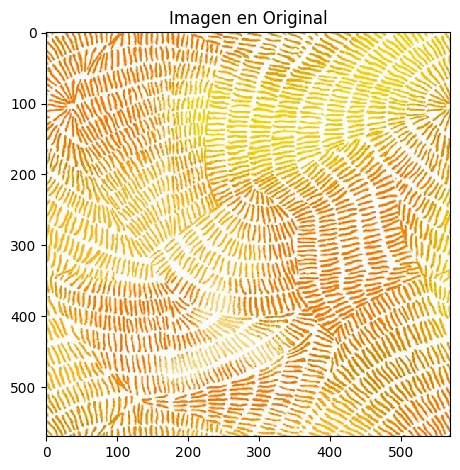

In [ ]:
# Mostrar la imagen
plt.title('Imagen en Original')
io.imshow(image)
io.show()

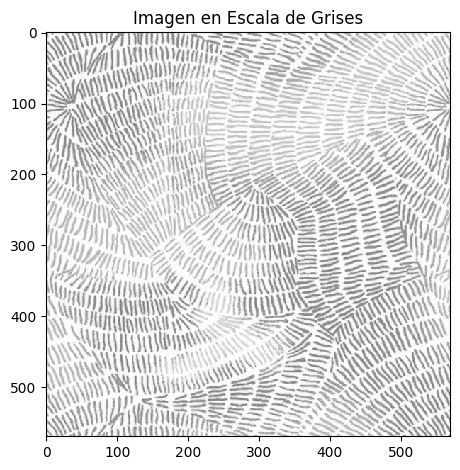

In [ ]:
# Convertir a escala de grises
gray_image = color.rgb2gray(image)


plt.title('Imagen en Escala de Grises')
io.imshow(gray_image)
io.show()

**Probar umbralización global**

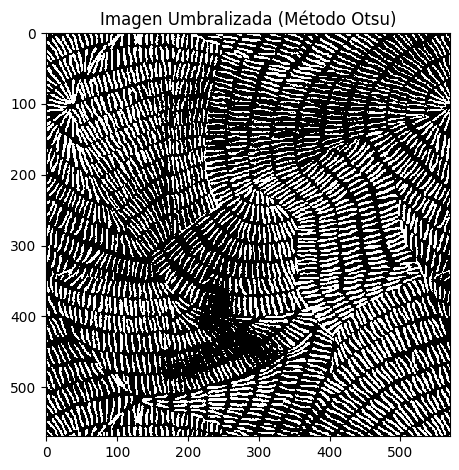

In [ ]:
#Calcula el umbral optimo con el metodo de Otsu
thresh=threshold_otsu(gray_image)

#Umbraliza la imagen
binary=gray_image<thresh

# Mostrar la imagen binaria
plt.title('Imagen Umbralizada (Método Otsu)')
io.imshow(binary)
io.show()


La imagen tiene algunas sombras lo que hace que haya regiones en las que no se ven lineas que hay debajo. por lo que voy a probar umbralizacion adaptativa

**Probar umbralizacion adaptativa**



SAUVOLA

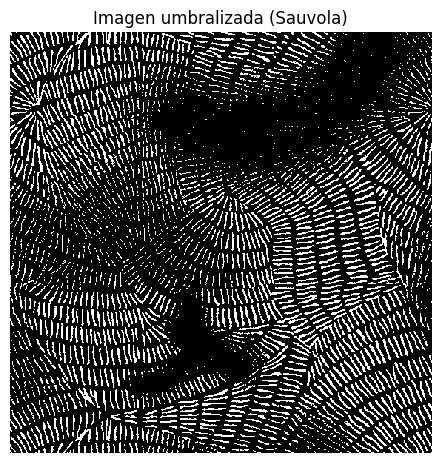

In [ ]:
from skimage.filters import threshold_sauvola

# Calcular el umbral de Sauvola
window_size = 25  # Tamaño de la ventana
thresh_sauvola = threshold_sauvola(gray_image, window_size=window_size, k=0.2)

# Umbraliza la imagen usando Sauvola
binary_sauvola = gray_image < thresh_sauvola

# Mostrar la imagen umbralizada
io.imshow(binary_sauvola)
plt.title("Imagen umbralizada (Sauvola)")
plt.axis('off')  # Oculta los ejes
plt.show()


Sale peor

NIBLACK

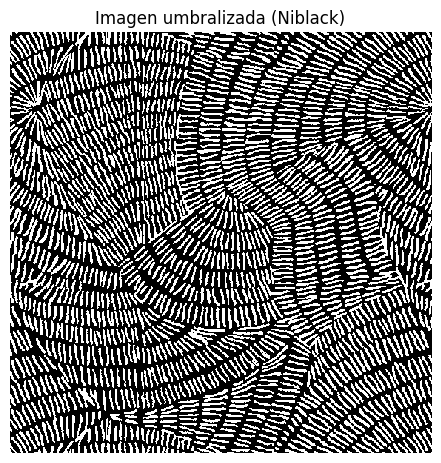

In [ ]:
from skimage.filters import threshold_niblack

# Calcular el umbral de Niblack
window_size = 25  # Tamaño de la ventana (ajústalo según sea necesario)
thresh_niblack = threshold_niblack(gray_image, window_size=window_size, k=0.2)

# Umbraliza la imagen usando Niblack
binary_niblack = gray_image < thresh_niblack

# Mostrar la imagen umbralizada
io.imshow(binary_niblack)
plt.title("Imagen umbralizada (Niblack)")
plt.axis('off')  # Oculta los ejes
plt.show()

Sale muy bien con umbralizacion adaptativa Niblack , no se ven sombras

GAUSSIANA

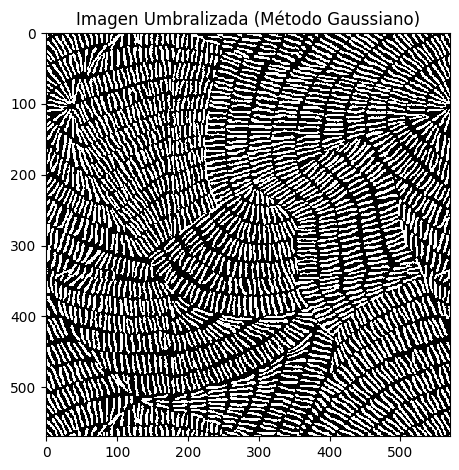

In [ ]:
# Aplicar umbralización adaptativa Gaussiana
window_size = 25  # Tamaño de la ventana para calcular el umbral local
thresh_gaussian = filters.threshold_local(gray_image, block_size=window_size, method='gaussian')

# Umbralizar la imagen
binary_gaussian = gray_image < thresh_gaussian

# Mostrar la imagen umbralizada
plt.title('Imagen Umbralizada (Método Gaussiano)')
io.imshow(binary_gaussian)
io.show()



MEAN

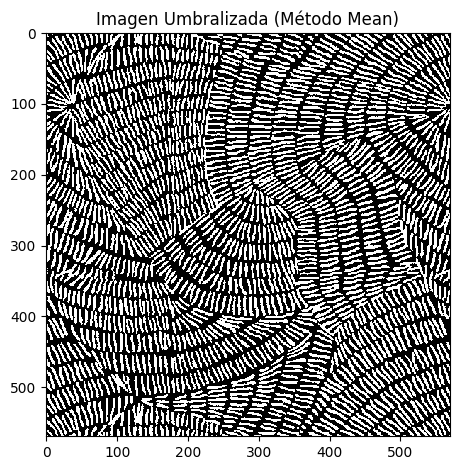

In [ ]:
# Aplicar umbralización adaptativa con el método Mean
window_size = 25  # Tamaño de la ventana para calcular el umbral local
thresh_mean = filters.threshold_local(gray_image, block_size=window_size, method='mean')

# Umbralizar la imagen
binary_mean = gray_image < thresh_mean

# Mostrar la imagen umbralizada
plt.title('Imagen Umbralizada (Método Mean)')
io.imshow(binary_mean)
io.show()

Tras realizar las umbralizaciones adaptativas las que mejor van son nIBLACK gaussiana y Mean. Nos quedamso con la de mean

**CONTAR CONTORNOS**

Número de contornos detectados: 1482


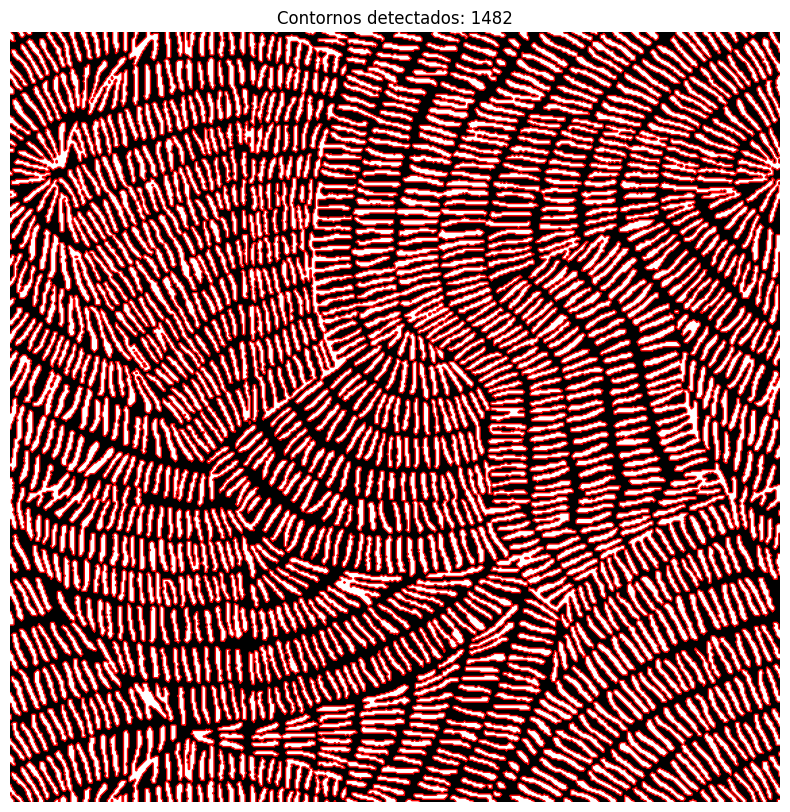

<Figure size 500x500 with 0 Axes>

In [ ]:
# Detectar contornos en la imagen binaria
contours = measure.find_contours(binary_mean, level=0.5)

# Dibujar los contornos detectados sobre la imagen umbralizada
fig, ax = plt.subplots(figsize=(10, 10))
ax.imshow(binary_mean, cmap='gray')

# Dibujar cada contorno
for contour in contours:
    ax.plot(contour[:, 1], contour[:, 0], color='red', linewidth=1)

# Contar cuántos contornos fueron detectados
contour_count = len(contours)
print(f'Número de contornos detectados: {contour_count}')

# Mostrar la imagen con los contornos detectados
plt.figure(figsize=(5, 5))
ax.set_title(f'Contornos detectados: {contour_count}')
ax.axis('off')
plt.show()

Contando contornos hay algunos que se juntan entonces cuenta varias rayas como 1

**CONTAR BLOBS**


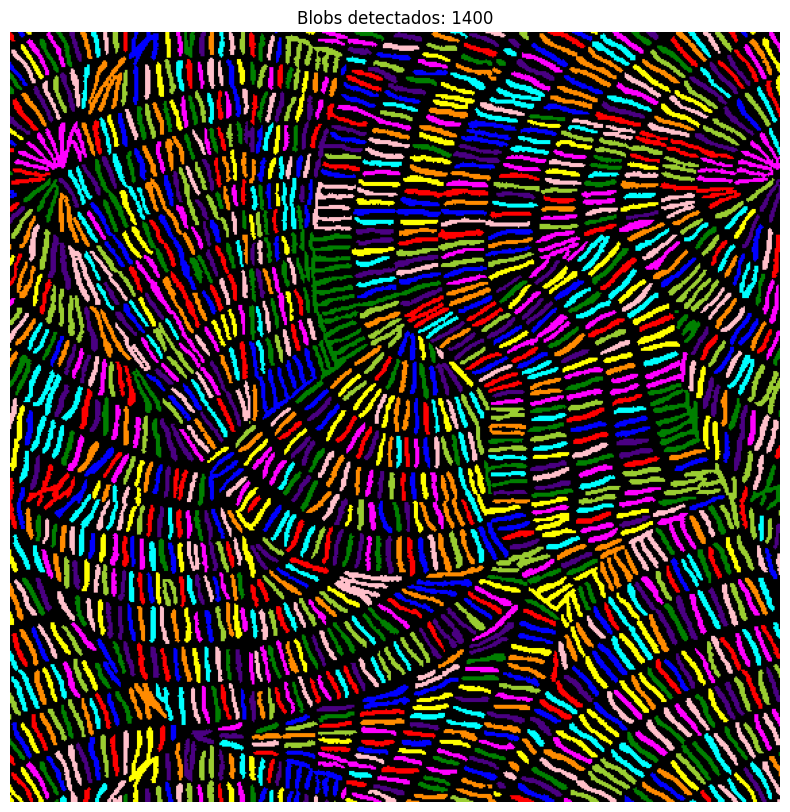

Número de blobs detectados: 1400


In [ ]:

# Detectar blobs en la imagen binaria
labeled_blobs = measure.label(binary_mean)
number_of_blobs = np.max(labeled_blobs)

# Mostrar la imagen con los blobs detectados
fig, ax = plt.subplots(figsize=(10, 10))
ax.imshow(color.label2rgb(labeled_blobs, bg_label=0), cmap='gray')
ax.set_title(f'Blobs detectados: {number_of_blobs}')
ax.axis('off')
plt.show()

print(f'Número de blobs detectados: {number_of_blobs}')


**OPERACINES MORFOLOGICAS**

APERTURA: EROSION+DILATACION

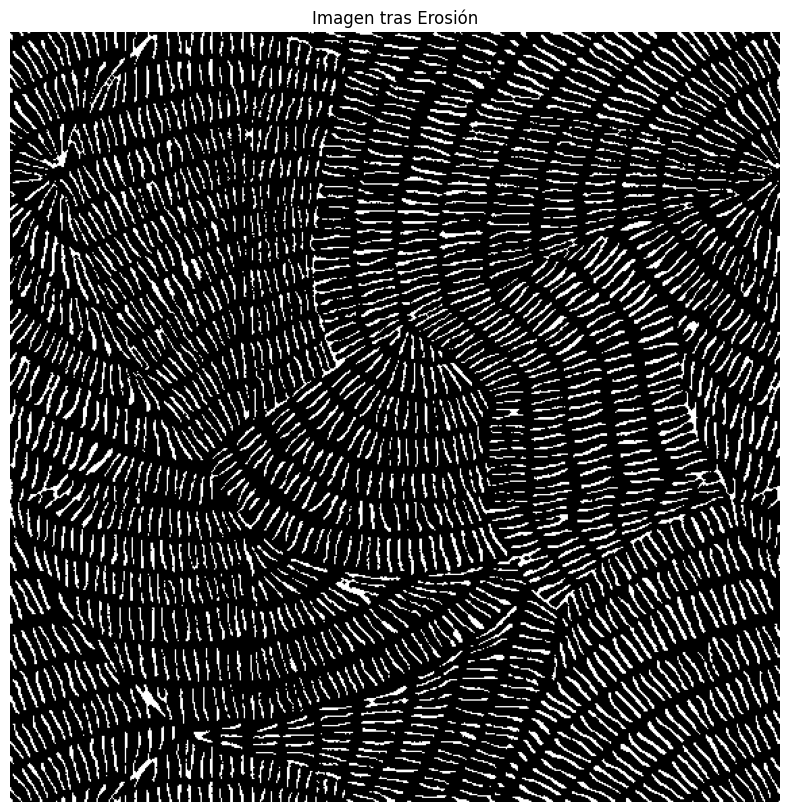

In [ ]:

# Crear un elemento estructurante circular con radio 1
selem = disk(1)

eroded = erosion(binary_mean, selem)

# Mostrar la imagen erosionada
plt.figure(figsize=(10, 10))
plt.imshow(eroded, cmap='gray')
plt.title('Imagen tras Erosión')
plt.axis('off')
plt.show()

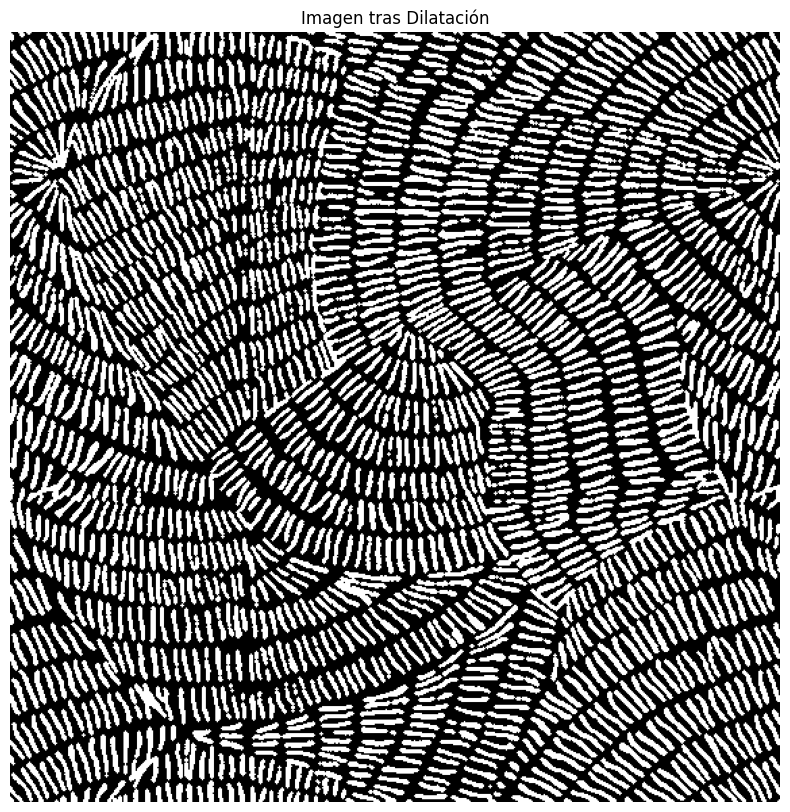

In [ ]:

selem=disk(1)
dilated = dilation(eroded, selem)

# Mostrar la imagen dilatada
plt.figure(figsize=(10, 10))
plt.imshow(dilated, cmap='gray')
plt.title('Imagen tras Dilatación')
plt.axis('off')
plt.show()

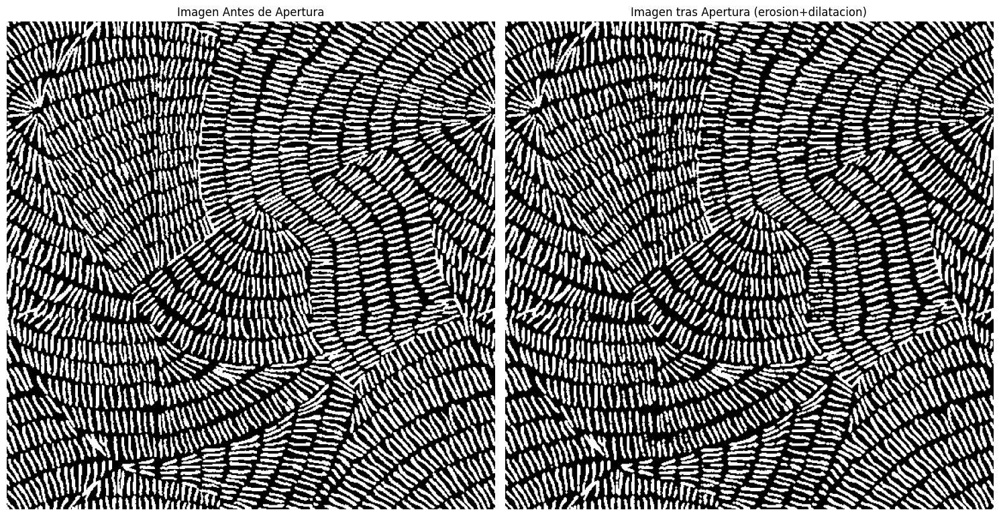

In [ ]:
# Mostrar la imagen antes y después de la apertura
fig, axes = plt.subplots(1, 2, figsize=(15, 10))

# Imagen antes de la apertura
axes[0].imshow(binary_mean, cmap='gray')
axes[0].set_title('Imagen Antes de Apertura')
axes[0].axis('off')

# Imagen después de la apertura
axes[1].imshow(dilated, cmap='gray')
axes[1].set_title('Imagen tras Apertura (erosion+dilatacion)')
axes[1].axis('off')

plt.tight_layout()
plt.show()

Parece que alguas rayitas se separan, por lo que vamosa  probar clausura

CLAUSURA= DILATACION + EROSION

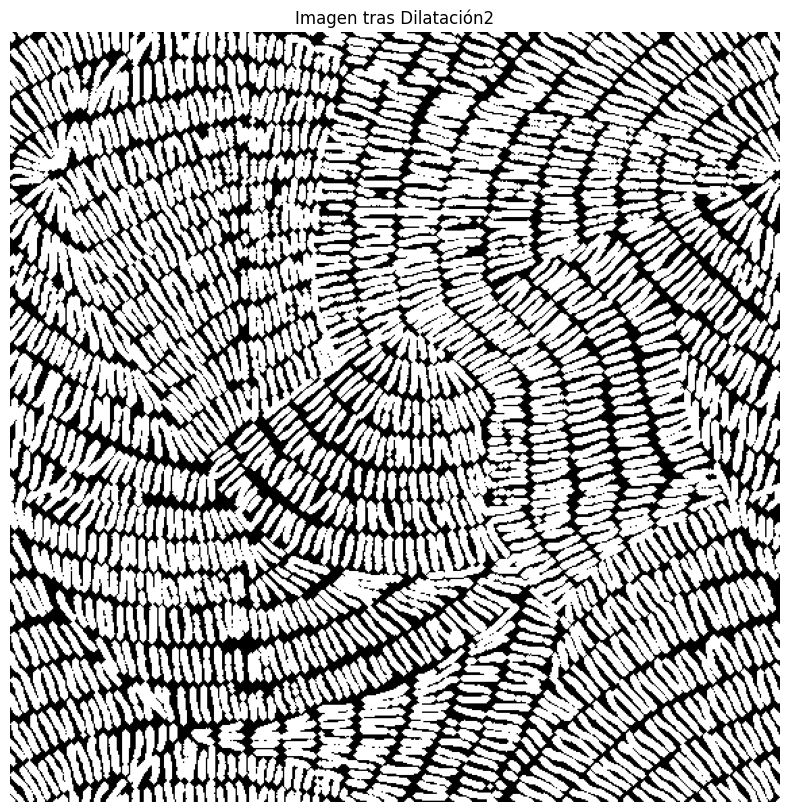

In [ ]:
selem=disk(1)
dilated2 = dilation(dilated, selem)

# Mostrar la imagen dilatada
plt.figure(figsize=(10, 10))
plt.imshow(dilated2, cmap='gray')
plt.title('Imagen tras Dilatación2')
plt.axis('off')
plt.show()

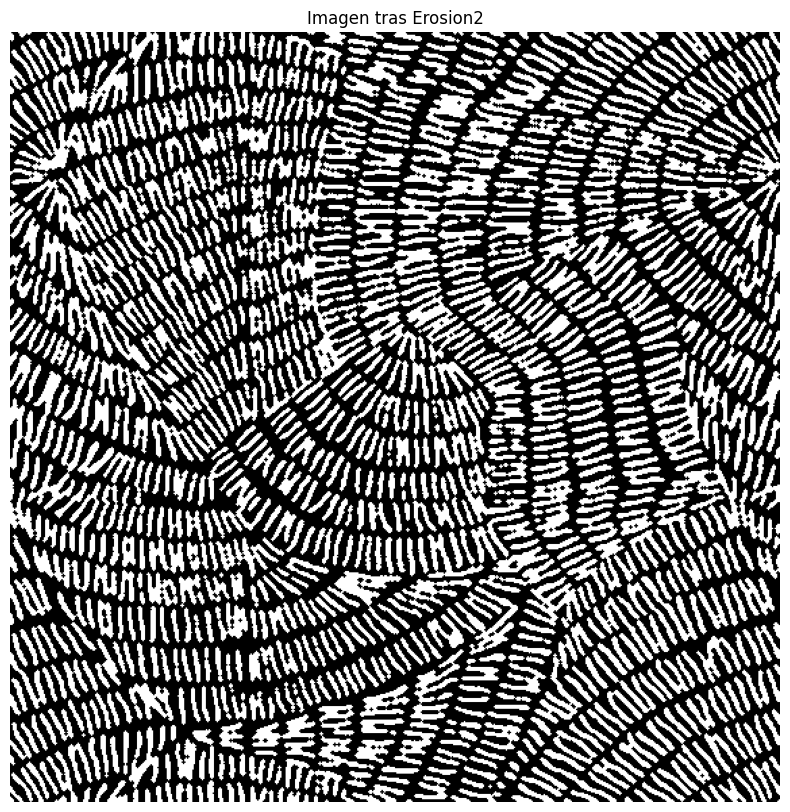

In [ ]:
selem=disk(1)
eroded2 = erosion(dilated2, selem)

# Mostrar la imagen
plt.figure(figsize=(10, 10))
plt.imshow(eroded2, cmap='gray')
plt.title('Imagen tras Erosion2')
plt.axis('off')
plt.show()

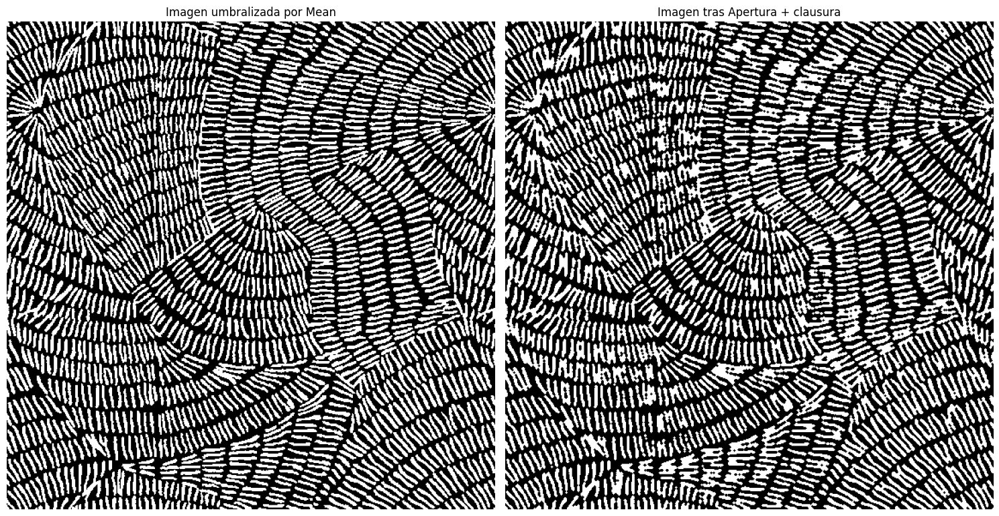

In [ ]:
# Mostrar la imagen antes y después de la apertura + clausura
fig, axes = plt.subplots(1, 2, figsize=(15, 10))

# Imagen antes
axes[0].imshow(binary_mean, cmap='gray')
axes[0].set_title('Imagen umbralizada por Mean')
axes[0].axis('off')

# Imagen después de la Apertura+ Clausura
axes[1].imshow(eroded2, cmap='gray')
axes[1].set_title('Imagen tras Apertura + clausura')
axes[1].axis('off')

plt.tight_layout()
plt.show()

No sale muy bien tampoco

PROBAR CLAUSURA DIRECTAMENTE DE LA IMAGEN BINARIA

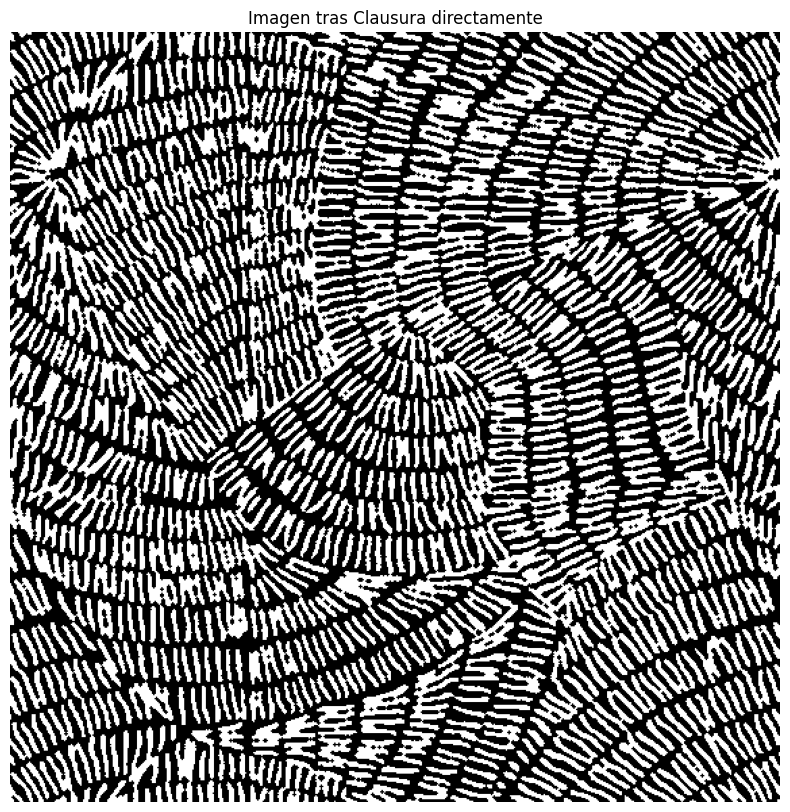

In [ ]:
# Aplicar Clausura
closed = morphology.closing(binary_mean, morphology.disk(1))

# Mostrar la imagen tras clausura
plt.figure(figsize=(10, 10))
plt.imshow(closed, cmap='gray')
plt.title('Imagen tras Clausura directamente')
plt.axis('off')
plt.show()

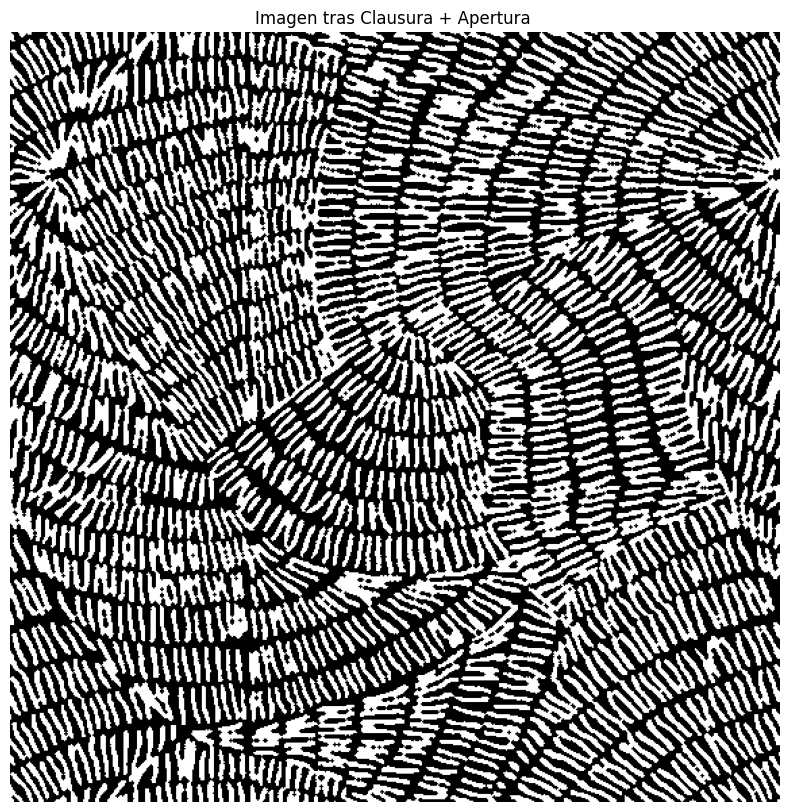

In [ ]:
# Aplicar Clausura
openedTrasClausura = morphology.closing(closed, morphology.disk(1))

# Mostrar la imagen tras clausura
plt.figure(figsize=(10, 10))
plt.imshow(closed, cmap='gray')
plt.title('Imagen tras Clausura + Apertura ')
plt.axis('off')
plt.show()

Tampoco mejora

Probar apertura con un elemento cuandrado

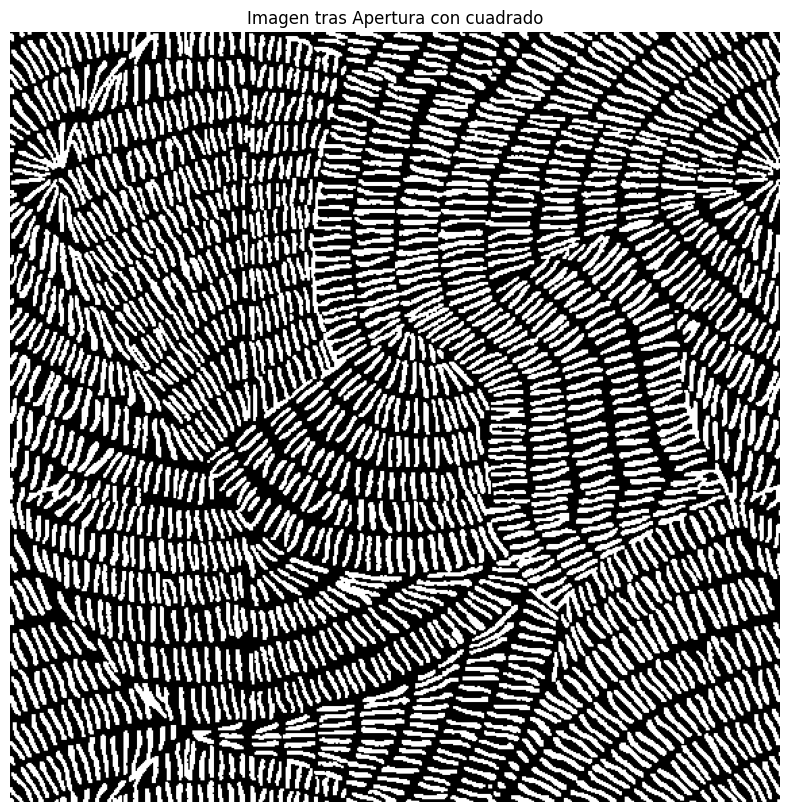

In [ ]:
# Aplicar una operación de apertura para reducir el ruido con una estructura cuadrada
opened_imageC = morphology.opening(binary_mean, morphology.square(2))

# Mostrar la imagen tras apertura
plt.figure(figsize=(10, 10))
plt.imshow(opened_imageC, cmap='gray')
plt.title('Imagen tras Apertura con cuadrado')
plt.axis('off')
plt.show()


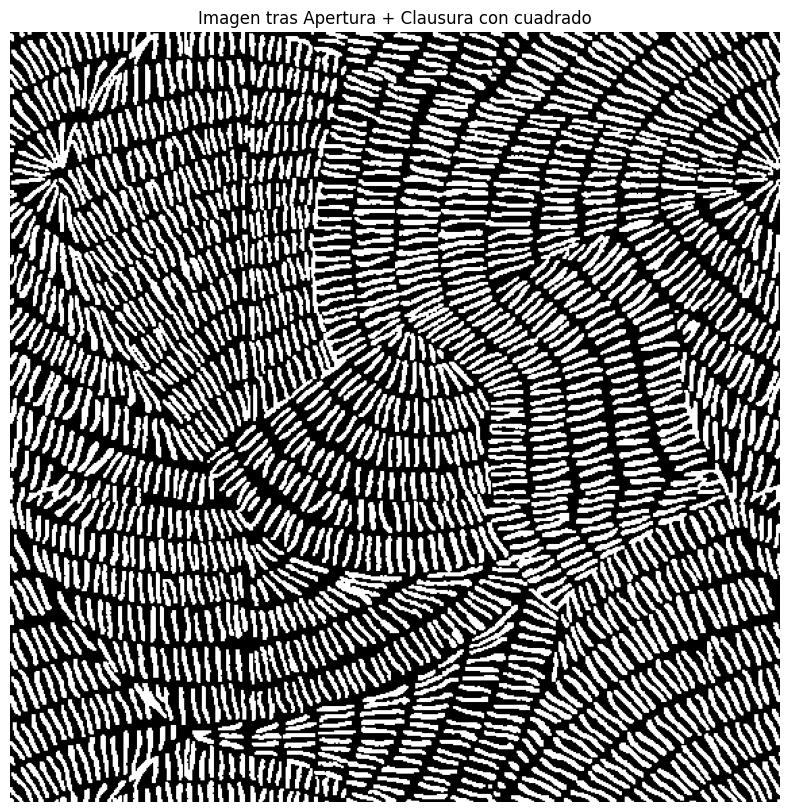

In [ ]:
# Aplicar una operación de apertura para reducir el ruido con una estructura cuadrada
closed_imageC = morphology.closing(opened_imageC, morphology.square(2))

# Mostrar la imagen tras clausura
plt.figure(figsize=(10, 10))
plt.imshow(opened_imageC, cmap='gray')
plt.title('Imagen tras Apertura + Clausura con cuadrado')
plt.axis('off')
plt.show()

Probar con elemto estructurante rectangular ya que son rayitas

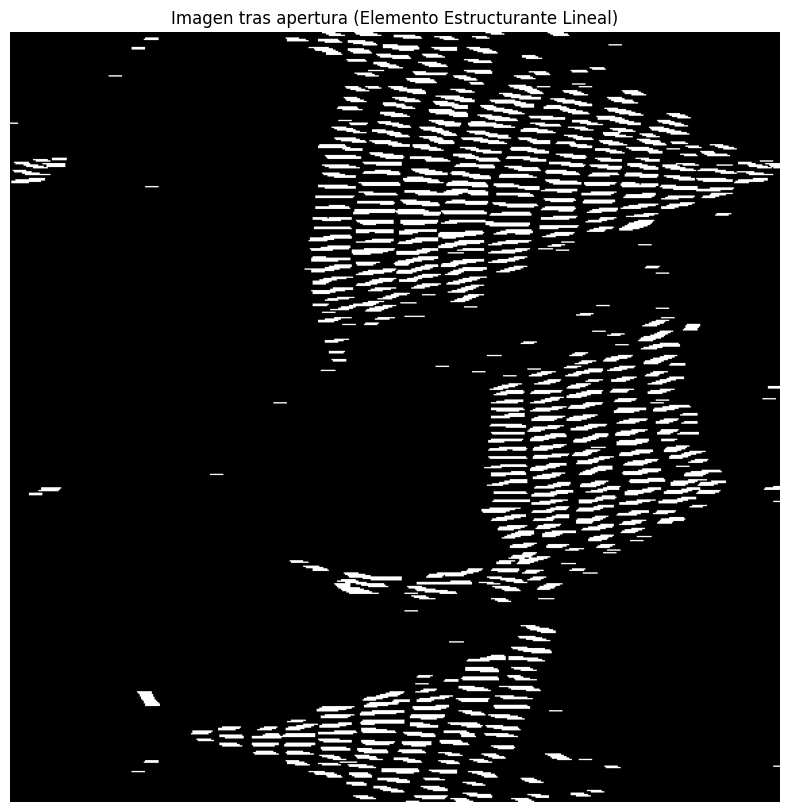

In [ ]:
# Aplicar Clausura con un elemento estructurante lineal (rectangular)
selem = morphology.rectangle(1, 10)  # Rectángulo de 1x10 para trabajar mejor con líneas horizontales
opened_R = morphology.opening(binary_mean, selem)

# Mostrar la imagen tras clausura
plt.figure(figsize=(10, 10))
plt.imshow(opened_R, cmap='gray')
plt.title('Imagen tras apertura (Elemento Estructurante Lineal)')
plt.axis('off')
plt.show()

No sale bien la apertura con un elemento estructurante rectangular ya que no todos estan en la misma *direccion*

Multiples iteraciones con elemtro cuadrado

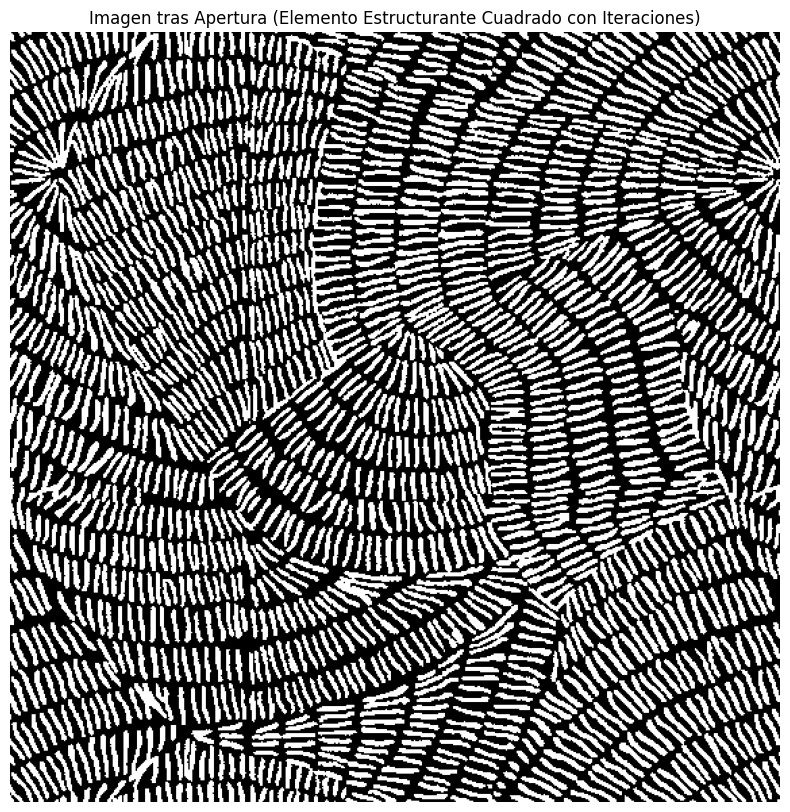

In [ ]:

# Aplicar Apertura con un elemento estructurante cuadrado y varias iteraciones
selem = morphology.square(1)  # Cuadrado para trabajar mejor con líneas en varias direcciones


# Realizar múltiples iteraciones de apertura para mejorar la eliminación de ruido
for _ in range(3):  # Realizar 3 iteraciones de apertura
    opened_Sq = morphology.opening(binary_mean, selem)

# Mostrar la imagen tras apertura
plt.figure(figsize=(10, 10))
plt.imshow(opened_Sq, cmap='gray')
plt.title('Imagen tras Apertura (Elemento Estructurante Cuadrado con Iteraciones)')
plt.axis('off')
plt.show()

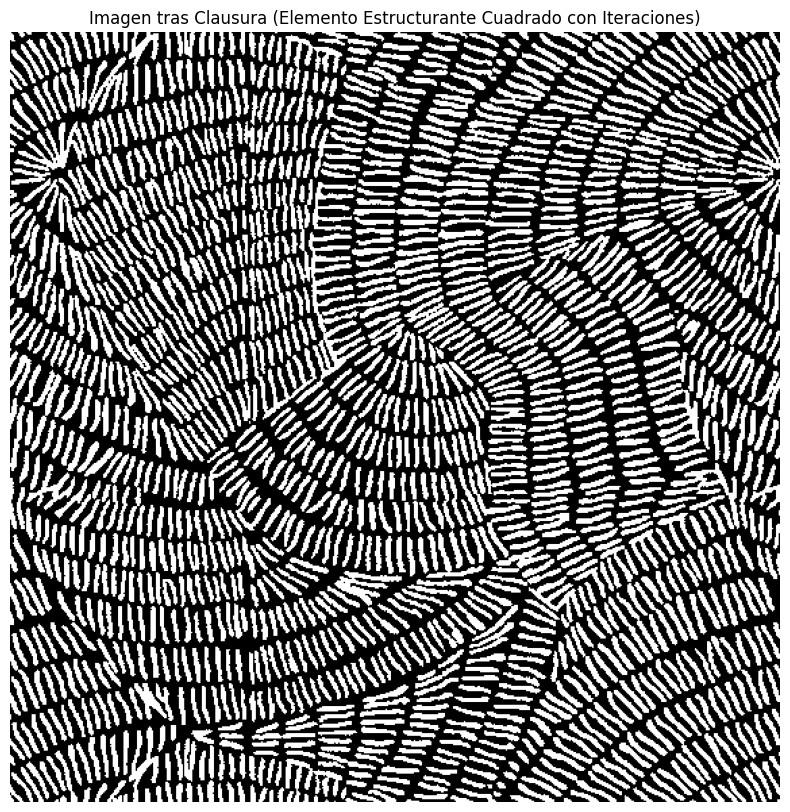

In [ ]:
# Aplicar Clausura con un elemento estructurante cuadrado y varias iteraciones
selem = morphology.square(1)  # Cuadrado de 3x3 para trabajar mejor con líneas en varias direcciones

# Realizar múltiples iteraciones de clausura para mejorar la conectividad
for _ in range(3):  # Realizar 3 iteraciones de clausura
    closed_Sq = morphology.closing(opened_Sq, selem)

# Mostrar la imagen tras clausura
plt.figure(figsize=(10, 10))
plt.imshow(closed_Sq, cmap='gray')
plt.title('Imagen tras Clausura (Elemento Estructurante Cuadrado con Iteraciones)')
plt.axis('off')
plt.show()

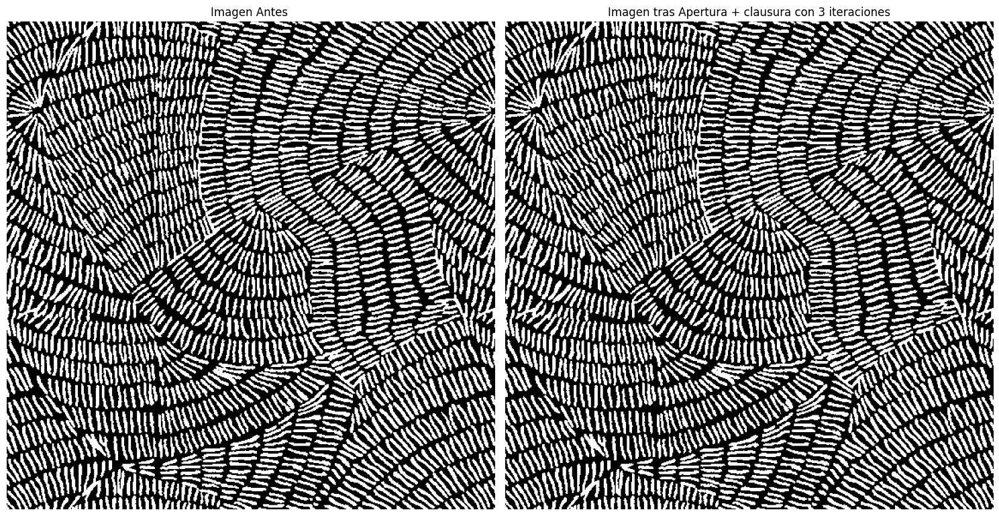

In [ ]:
# Mostrar la imagen antes y después de la apertura + clausura
fig, axes = plt.subplots(1, 2, figsize=(15, 10))

# Imagen antes de la apertura
axes[0].imshow(binary_mean, cmap='gray')
axes[0].set_title('Imagen Antes ')
axes[0].axis('off')

# Imagen después
axes[1].imshow(closed_Sq, cmap='gray')
axes[1].set_title('Imagen tras Apertura + clausura con 3 iteraciones')
axes[1].axis('off')

plt.tight_layout()
plt.show()

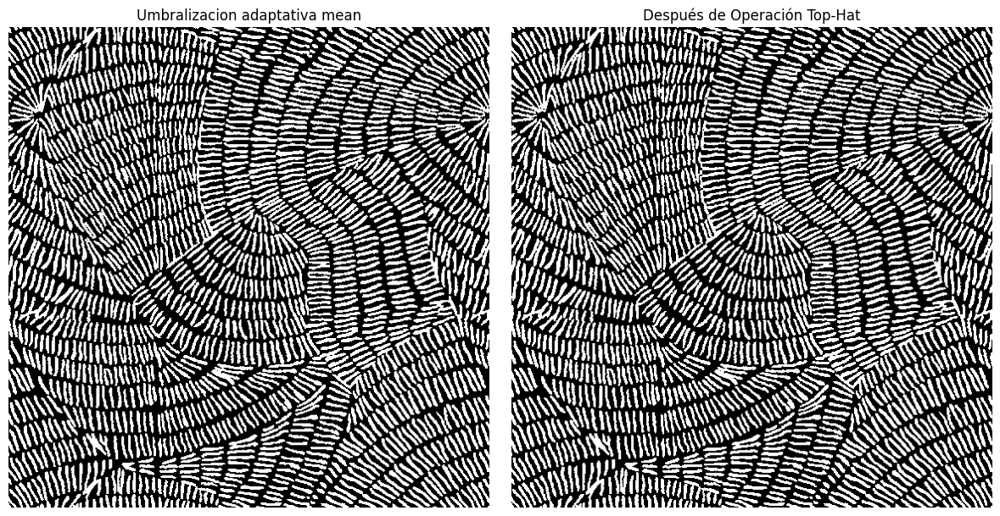

In [ ]:


# Definir elementos estructurantes en varias orientaciones
elemento_horizontal = rectangle(1, 15)  # Rectángulo horizontal
elemento_vertical = rectangle(15, 1)    # Rectángulo vertical
elemento_diagonal_1 = rectangle(3, 7)   # Rectángulo diagonal (inclinación suave)
elemento_diagonal_2 = rectangle(7, 3)   # Otro rectángulo diagonal

# Aplicar operación Top-Hat con diferentes elementos estructurantes
resultado_horizontal = white_tophat(binary_mean, elemento_horizontal)
resultado_vertical = white_tophat(binary_mean, elemento_vertical)
resultado_diagonal_1 = white_tophat(binary_mean, elemento_diagonal_1)
resultado_diagonal_2 = white_tophat(binary_mean, elemento_diagonal_2)

# Combinar los resultados para obtener una imagen mejorada
resultado_final = np.maximum.reduce([resultado_horizontal, resultado_vertical, resultado_diagonal_1, resultado_diagonal_2])

# Mostrar los resultados
plt.figure(figsize=(12, 6))

# Imagen tras umbralización adaptativa
plt.subplot(1, 2, 1)
plt.title('Umbralizacion adaptativa mean')
plt.imshow(binary_mean, cmap='gray')
plt.axis('off')

# Imagen después de la combinación de Top-Hat
plt.subplot(1, 2, 2)
plt.title('Después de Operación Top-Hat')
plt.imshow(resultado_final, cmap='gray')
plt.axis('off')

plt.tight_layout()
plt.show()

**DETECTAR LINEAS**

Número de blobs detectados: 1400


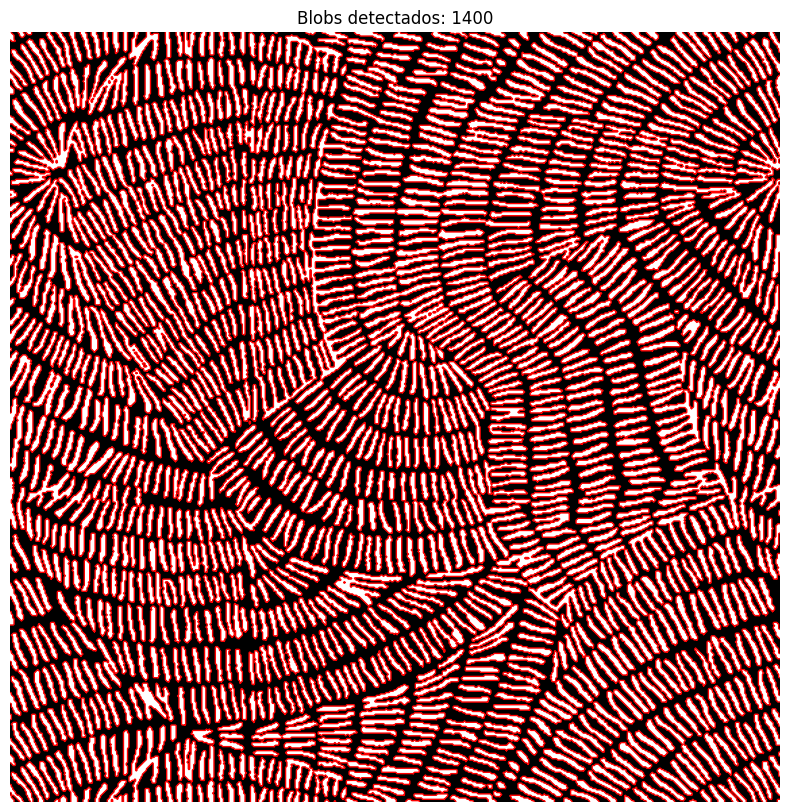

In [ ]:
# Etiquetar los blobs en la imagen binaria
label_image = measure.label(closed_Sq, connectivity=2)

# Encontrar los contornos de cada blob etiquetado
fig, ax = plt.subplots(figsize=(10, 10))
ax.imshow(binary_mean, cmap='gray')

# Dibujar los contornos de cada blob detectado
for region in measure.regionprops(label_image):
    # Obtener las coordenadas del contorno del blob
    minr, minc, maxr, maxc = region.bbox
    contour = measure.find_contours(label_image == region.label, level=0.5)
    for cont in contour:
        ax.plot(cont[:, 1], cont[:, 0], color='red', linewidth=1)

# Contar el número de blobs detectados
blob_count = len(measure.regionprops(label_image))
print(f'Número de blobs detectados: {blob_count}')

# Mostrar la imagen con los blobs marcados
ax.set_title(f'Blobs detectados: {blob_count}')
ax.axis('off')
plt.show()

Número de blobs detectados: 1400


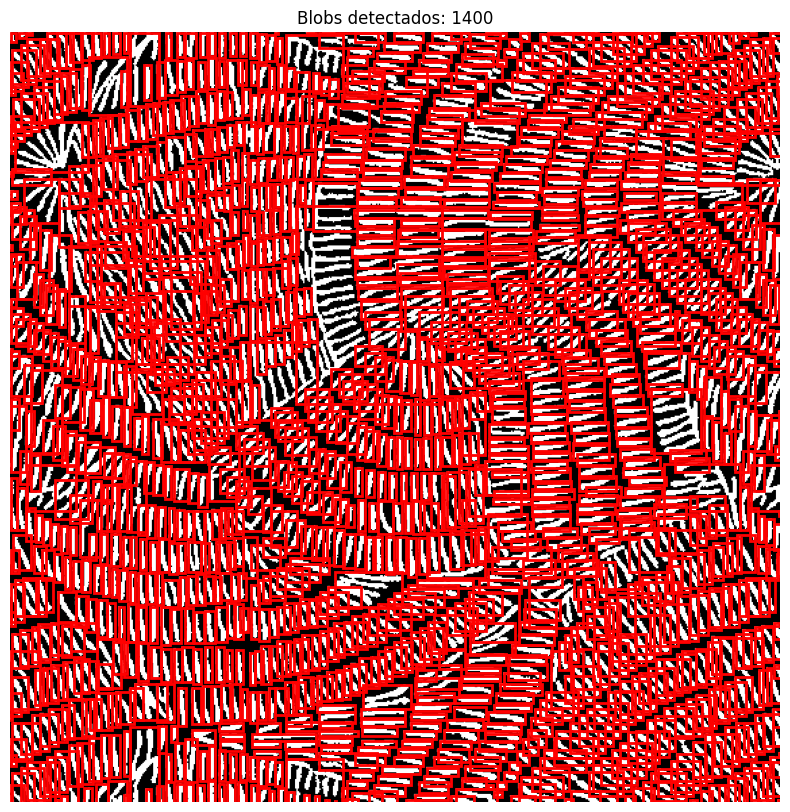

In [ ]:
# Etiquetar los blobs en la imagen binaria
label_image = measure.label(closed_Sq, connectivity=2)

# Contar el número de blobs detectados
blob_count = np.max(label_image)
print(f'Número de blobs detectados: {blob_count}')

# Mostrar la imagen con los blobs etiquetados
fig, ax = plt.subplots(figsize=(10, 10))
ax.imshow(binary_mean, cmap='gray')

# Dibujar los contornos de cada blob detectado
for region in measure.regionprops(label_image):
    minr, minc, maxr, maxc = region.bbox
    rect = plt.Rectangle((minc, minr), maxc - minc, maxr - minr, fill=False, edgecolor='red', linewidth=2)
    ax.add_patch(rect)

ax.set_title(f'Blobs detectados: {blob_count}')
ax.axis('off')
plt.show()

Sigue cogiendo muchos que estan pegados como uno

**Detectar bordes con Canny**

Número de rayitas detectadas: 1377


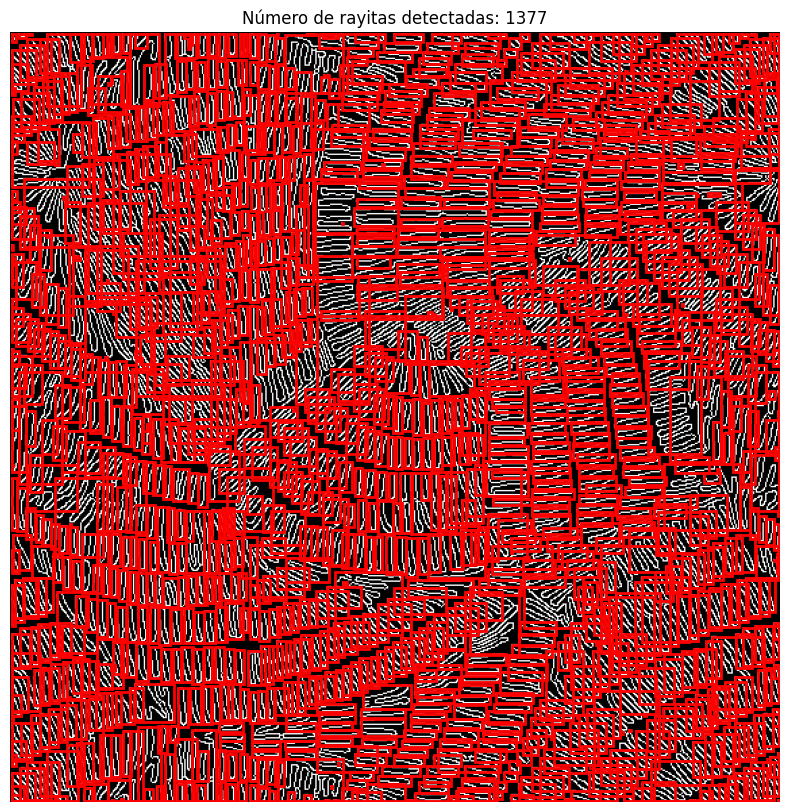

In [ ]:



# Aplicar el detector de bordes Canny
edges_canny = feature.canny(binary_mean,sigma=1.0, low_threshold=0.1, high_threshold=0.3)

# Etiquetar los bordes detectados para contar las rayitas
label_image = measure.label(edges_canny, connectivity=2)

# Contar el número de rayitas (bordes detectados)
rayas_count = np.max(label_image)
print(f'Número de rayitas detectadas: {rayas_count}')

# Mostrar la imagen con los blobs etiquetados
fig, ax = plt.subplots(figsize=(10, 10))
ax.imshow(edges_canny, cmap='gray')

# Dibujar los contornos de cada blob detectado
for region in measure.regionprops(label_image):
    minr, minc, maxr, maxc = region.bbox
    rect = plt.Rectangle((minc, minr), maxc - minc, maxr - minr, fill=False, edgecolor='red', linewidth=2)
    ax.add_patch(rect)

ax.set_title(f'Número de rayitas detectadas: {rayas_count}')
ax.axis('off')
plt.show()

Número de rayitas detectadas: 283


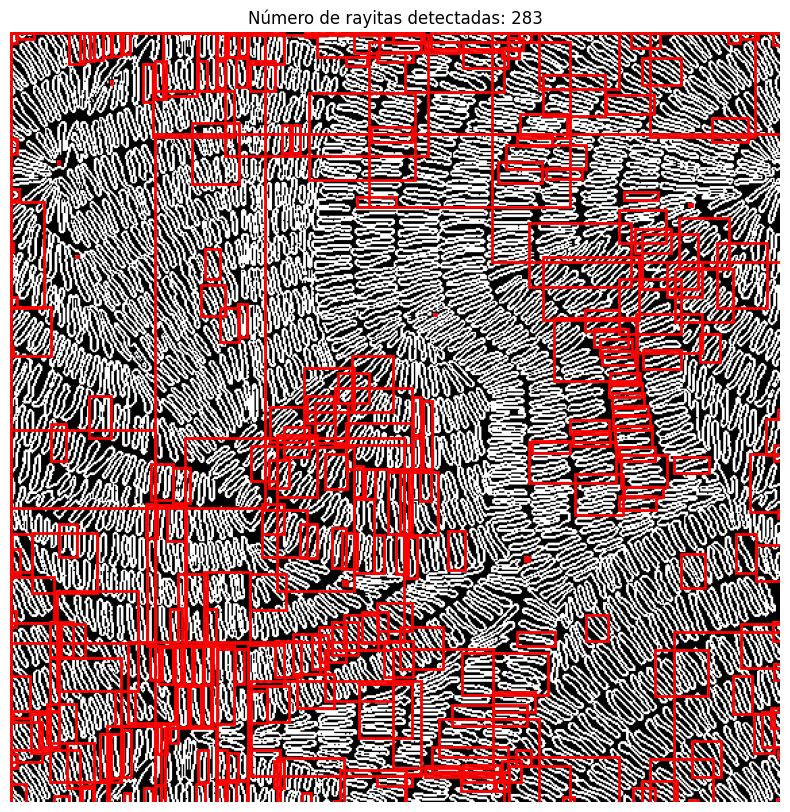

In [ ]:
# Aplicar el filtro Sobel a la imagen umbralizada
edges_sobel = sobel(binary_mean)

# Binarizar la imagen de bordes usando umbralización adaptativa con método Mean
window_size = 25  # Tamaño de la ventana
adaptive_thresh = threshold_local(edges_sobel, block_size=window_size, method='mean')
binary_edges = edges_sobel > adaptive_thresh

# Etiquetar los blobs en la imagen binaria resultante de Sobel
label_image = measure.label(binary_edges, connectivity=2)

# Contar el número de rayitas (blobs detectados)
rayas_count = np.max(label_image)
print(f'Número de rayitas detectadas: {rayas_count}')

# Mostrar la imagen con los blobs etiquetados
fig, ax = plt.subplots(figsize=(10, 10))
ax.imshow(binary_edges, cmap='gray')

# Dibujar los contornos de cada blob detectado
for region in measure.regionprops(label_image):
    minr, minc, maxr, maxc = region.bbox
    rect = plt.Rectangle((minc, minr), maxc - minc, maxr - minr, fill=False, edgecolor='red', linewidth=2)
    ax.add_patch(rect)

ax.set_title(f'Número de rayitas detectadas: {rayas_count}')
ax.axis('off')
plt.show()

Número de rayitas detectadas: 1207


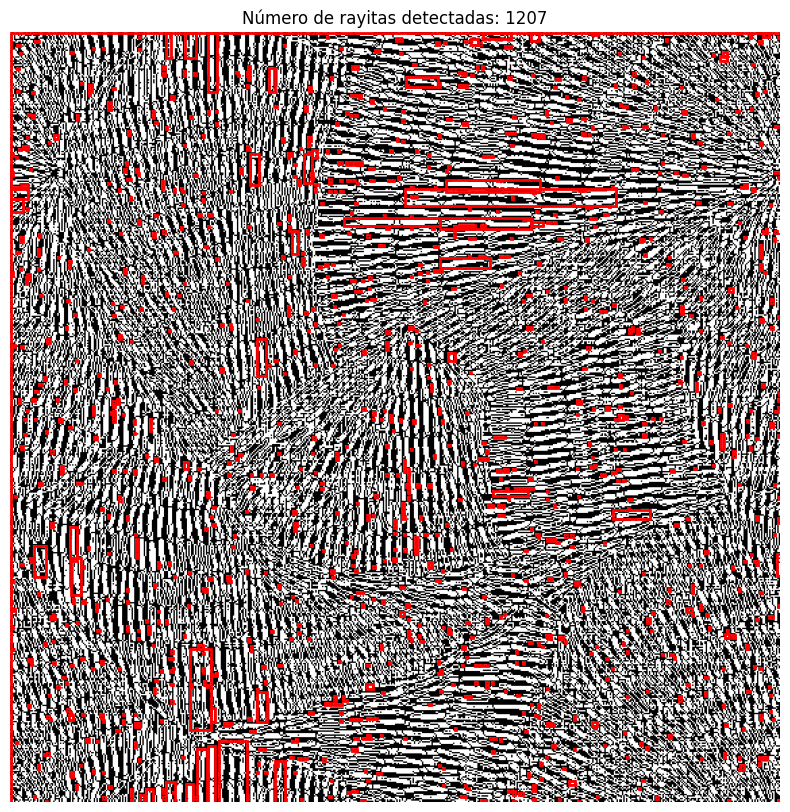

In [ ]:
# Aplicar el filtro Laplaciano a la imagen binarizada
edges_laplacian = filters.laplace(binary_mean)

# Binarizar la imagen de bordes usando umbralización adaptativa con el método Mean
window_size = 25  # Tamaño de la ventana para calcular el umbral local
adaptive_thresh = threshold_local(edges_laplacian, block_size=window_size, method='mean')

# Aplicar umbralización binaria
binary_edges = edges_laplacian > adaptive_thresh

# Etiquetar los blobs en la imagen binarizada resultante de Laplaciano
label_image = measure.label(binary_edges, connectivity=2)

# Contar el número de rayitas (blobs detectados)
rayas_count = np.max(label_image)
print(f'Número de rayitas detectadas: {rayas_count}')

# Mostrar la imagen con los blobs etiquetados
fig, ax = plt.subplots(figsize=(10, 10))
ax.imshow(binary_edges, cmap='gray')

# Dibujar los contornos de cada blob detectado
for region in measure.regionprops(label_image):
    minr, minc, maxr, maxc = region.bbox
    rect = plt.Rectangle((minc, minr), maxc - minc, maxr - minr, fill=False, edgecolor='red', linewidth=2)
    ax.add_patch(rect)

ax.set_title(f'Número de rayitas detectadas: {rayas_count}')
ax.axis('off')
plt.show()

SUAVIZADO GAUSIANO

Número de contornos detectados: 1369


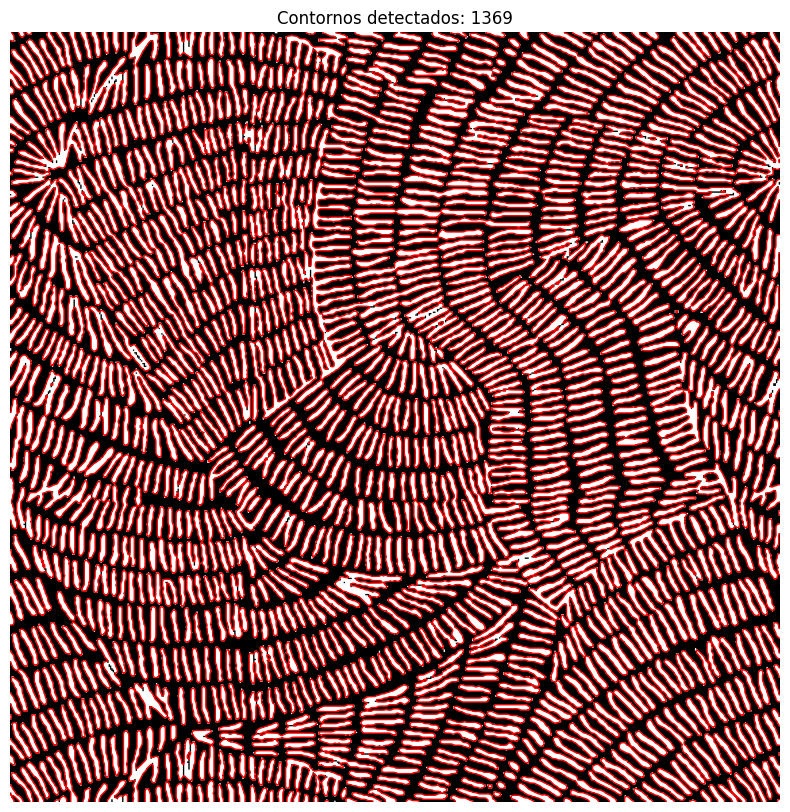

In [ ]:
# Aplicar un filtro Gaussiano para suavizar la imagen binarizada
sigma = 1.0  # Ajusta este parámetro para cambiar el nivel de suavizado
smoothed_image = gaussian(binary_mean, sigma=sigma)

# Detectar contornos en la imagen suavizada
contours = measure.find_contours(smoothed_image, level=0.5)

# Crear una figura para dibujar los contornos
fig, ax = plt.subplots(figsize=(10, 10))
ax.imshow(binary_mean, cmap='gray')

# Dibujar cada contorno detectado
for contour in contours:
    ax.plot(contour[:, 1], contour[:, 0], color='red', linewidth=1)

# Contar cuántos contornos fueron detectados
contour_count = len(contours)
print(f'Número de contornos detectados: {contour_count}')

# Mostrar la imagen con los contornos dibujados
ax.set_title(f'Contornos detectados: {contour_count}')
ax.axis('off')
plt.show()

Ninguno sale bien

LAS QUE MEJOR DE MOMENTO

**Imagen umbralizacion adaptativa con MEAN sin ninguna operacion morfocolgia, y se detectan contornos**

Número de contornos detectados: 1482


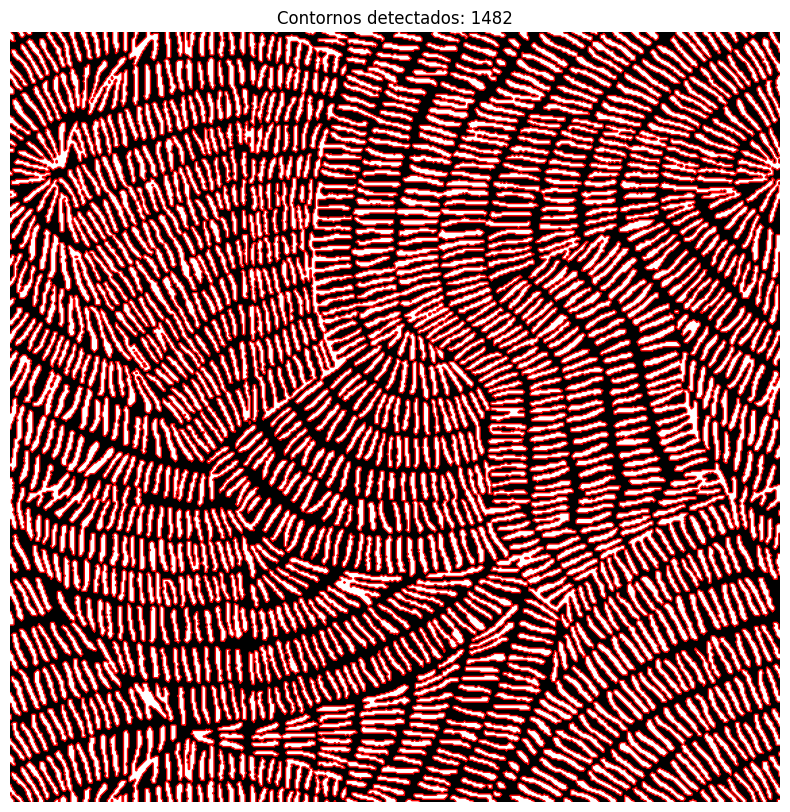

In [ ]:
# Detectar contornos en la imagen binaria
contours = measure.find_contours(binary_mean, level=0.5)

# Crear una figura para dibujar los contornos
fig, ax = plt.subplots(figsize=(10, 10))
ax.imshow(binary_mean, cmap='gray')

# Dibujar cada contorno
for contour in contours:
    ax.plot(contour[:, 1], contour[:, 0], color='red', linewidth=1)

# Contar cuántos contornos fueron detectados
contour_count = len(contours)
print(f'Número de contornos detectados: {contour_count}')

# Mostrar la imagen con los contornos dibujados
ax.set_title(f'Contornos detectados: {contour_count}')
ax.axis('off')
plt.show()

**Imagen umbralizacion adaptativa con MEAN tras apertura y se detectan contornos**

Número de contornos detectados: 1697


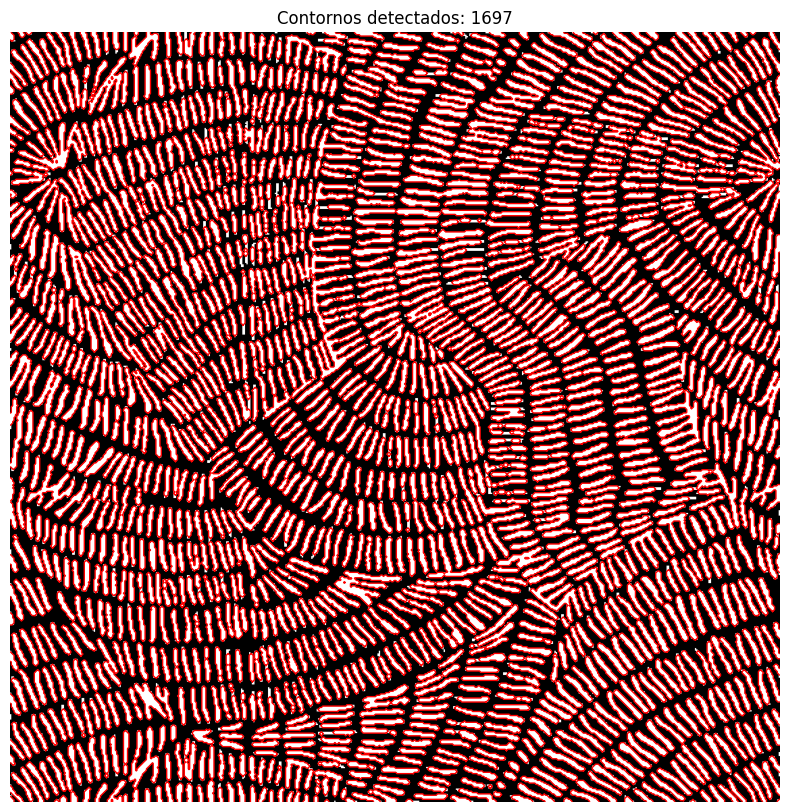

In [ ]:
# Detectar contornos en la imagen tras apertura (dilated)
contours = measure.find_contours(dilated, level=0.5)

# Crear una figura para dibujar los contornos
fig, ax = plt.subplots(figsize=(10, 10))
ax.imshow(binary_mean, cmap='gray')

# Dibujar cada contorno detectado
for contour in contours:
    ax.plot(contour[:, 1], contour[:, 0], color='red', linewidth=1)

# Contar cuántos contornos fueron detectados
contour_count = len(contours)
print(f'Número de contornos detectados: {contour_count}')

# Mostrar la imagen con los contornos dibujados
ax.set_title(f'Contornos detectados: {contour_count}')
ax.axis('off')
plt.show()

**Imagen umbralizacion adaptativa con MEAN sin ninguna operacion morfocolgia, y se detectan BLOBS**

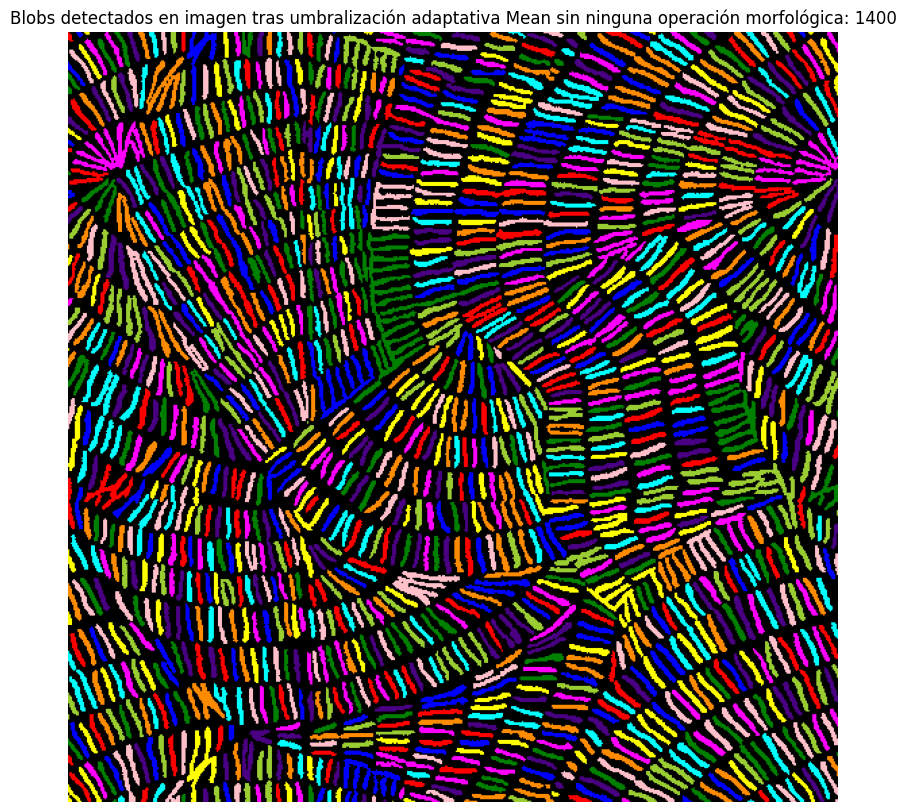

Número de blobs detectados: 1400


In [ ]:
# Detectar blobs en la imagen binaria
labeled_blobs = measure.label(binary_mean)
number_of_blobs = np.max(labeled_blobs)

# Mostrar la imagen con los blobs detectados
fig, ax = plt.subplots(figsize=(10, 10))
ax.imshow(color.label2rgb(labeled_blobs, bg_label=0), cmap='gray')
ax.set_title(f'Blobs detectados en imagen tras umbralización adaptativa Mean sin ninguna operación morfológica: {number_of_blobs}')
ax.axis('off')
plt.show()

print(f'Número de blobs detectados: {number_of_blobs}')


**Imagen umbralizacion adaptativa con MEAN tras apertura y se detectan BLOBS**

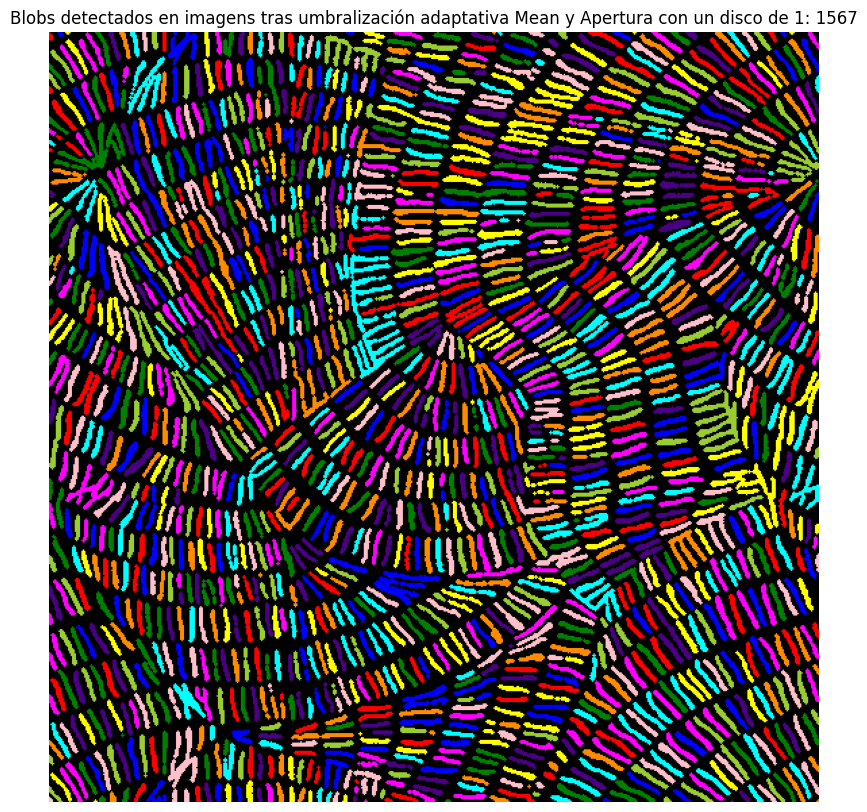

Número de blobs detectados: 1567


In [ ]:
# Detectar blobs en la imagen binaria
labeled_blobsA = measure.label(dilated)
number_of_blobs = np.max(labeled_blobsA)

# Mostrar la imagen con los blobs detectados
fig, ax = plt.subplots(figsize=(10, 10))
ax.imshow(color.label2rgb(labeled_blobsA, bg_label=0), cmap='gray')
ax.set_title(f'Blobs detectados en imagens tras umbralización adaptativa Mean y Apertura con un disco de 1: {number_of_blobs}')
ax.axis('off')
plt.show()

print(f'Número de blobs detectados: {number_of_blobs}')


Algunos se separan

Imagen erosionada

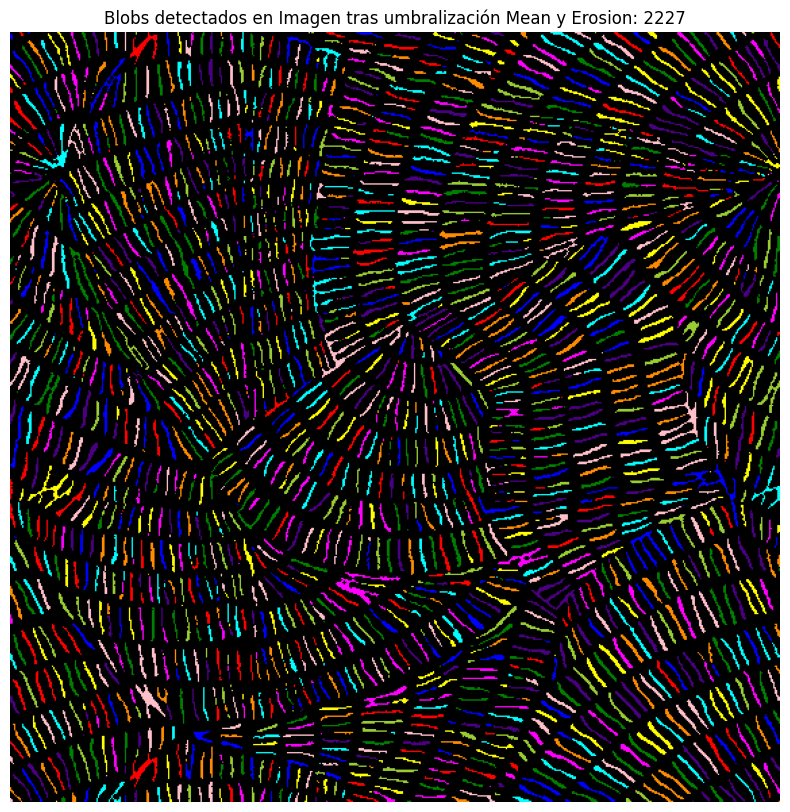

Número de blobs detectados: 2227


In [ ]:
# Detectar blobs en la imagen binaria
labeled_blobsE = measure.label(eroded)
number_of_blobs = np.max(labeled_blobsE)

# Mostrar la imagen con los blobs detectados
fig, ax = plt.subplots(figsize=(10, 10))
ax.imshow(color.label2rgb(labeled_blobsE, bg_label=0), cmap='gray')
ax.set_title(f'Blobs detectados en Imagen tras umbralización Mean y Erosion: {number_of_blobs}')
ax.axis('off')
plt.show()

print(f'Número de blobs detectados: {number_of_blobs}')


Alguno se queda dividido

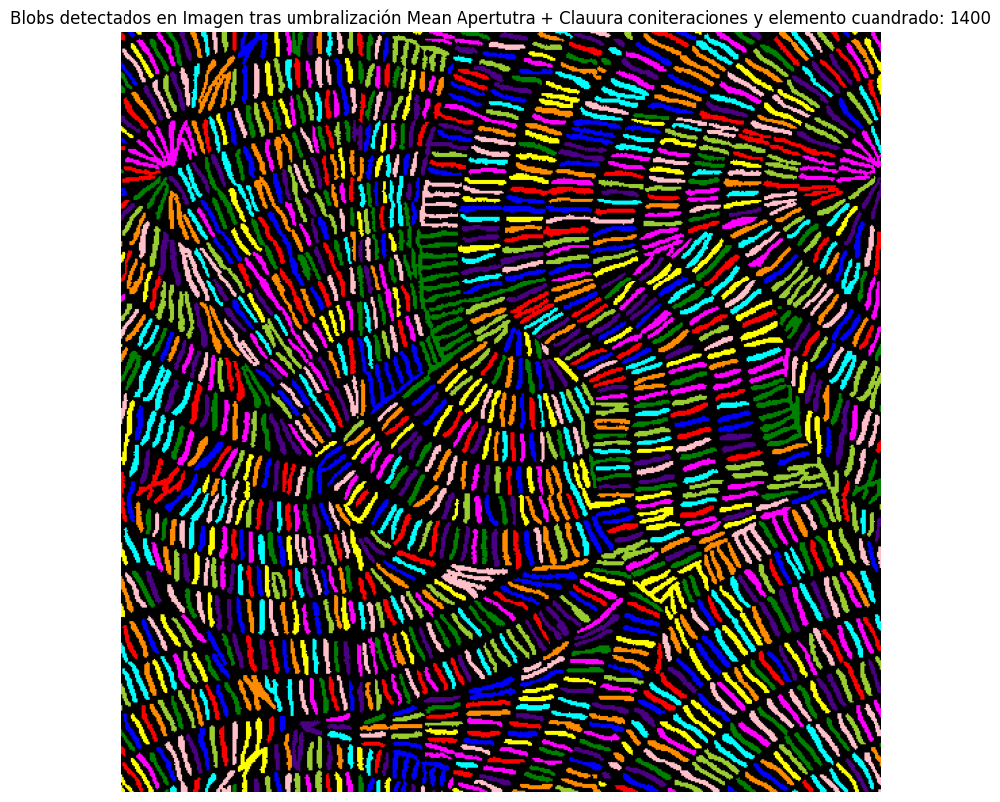

Número de blobs detectados: 1400


In [ ]:
# Detectar blobs en la imagen binaria
labeled_blobsSq = measure.label(closed_Sq)
number_of_blobs = np.max(labeled_blobsSq)

# Mostrar la imagen con los blobs detectados
fig, ax = plt.subplots(figsize=(10, 10))
ax.imshow(color.label2rgb(labeled_blobsSq, bg_label=0), cmap='gray')
ax.set_title(f'Blobs detectados en Imagen tras umbralización Mean Apertutra + Clauura coniteraciones y elemento cuandrado: {number_of_blobs}')
ax.axis('off')
plt.show()

print(f'Número de blobs detectados: {number_of_blobs}')


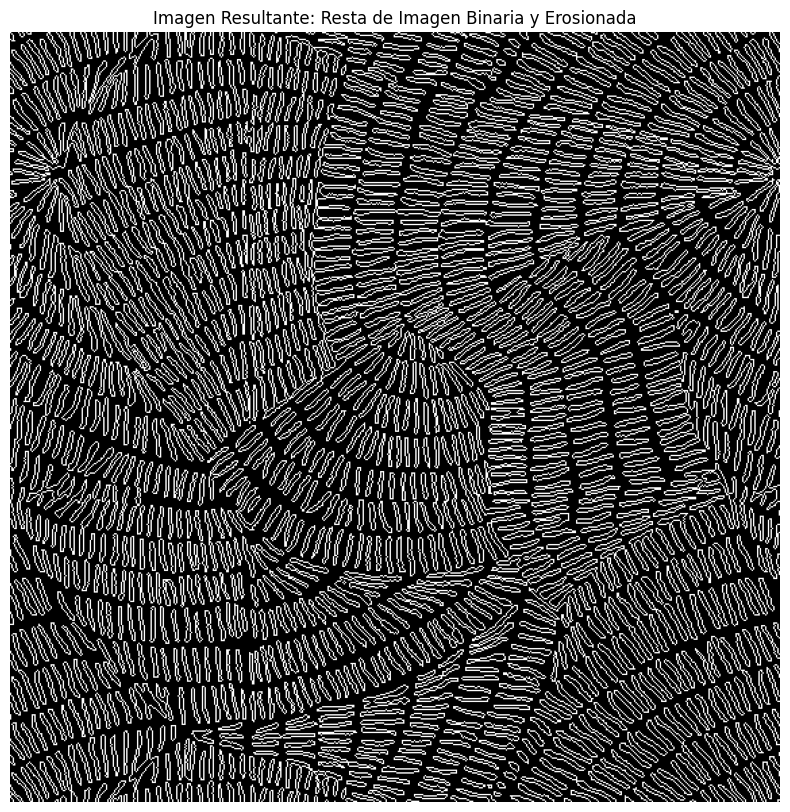

In [ ]:
# Restar la imagen erosionada de la imagen binaria original para resaltar los bordes
Resta = binary_mean &~eroded

# Mostrar la imagen resultante
plt.figure(figsize=(10, 10))
plt.imshow(Resta, cmap='gray')
plt.title('Imagen Resultante: Resta de Imagen Binaria y Erosionada')
plt.axis('off')
plt.show()


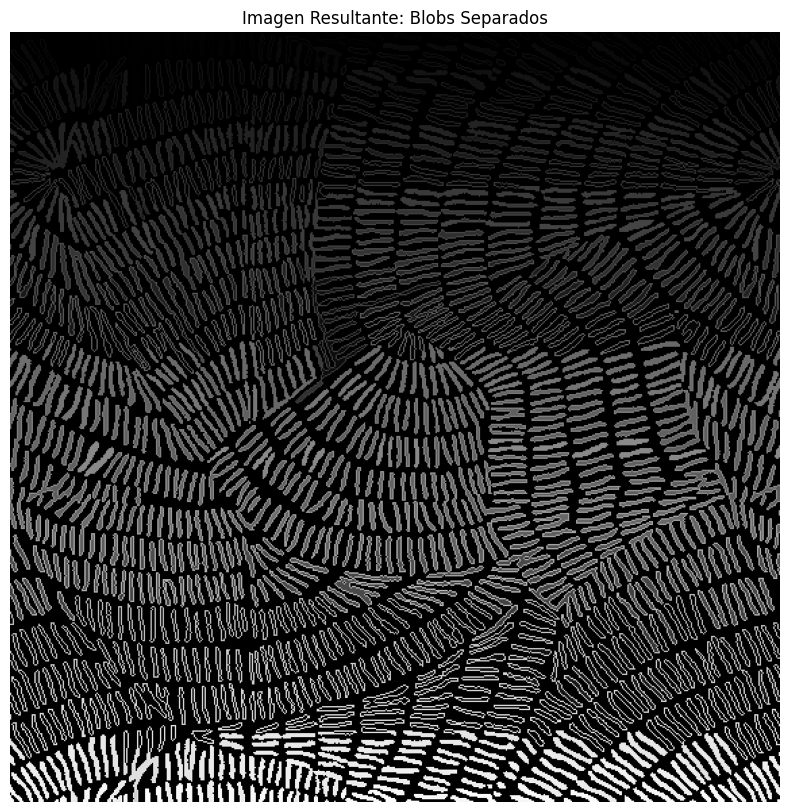

In [ ]:
# Restar la imagen erosionada de la imagen binaria original para resaltar los bordes
separated_blobs = labeled_blobsB &~labeled_blobsE

# Mostrar la imagen resultante
plt.figure(figsize=(10, 10))
plt.imshow(separated_blobs, cmap='gray')
plt.title('Imagen Resultante: Blobs Separados')
plt.axis('off')
plt.show()
